## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

Imports :

In [4]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
from collections import deque
%matplotlib inline

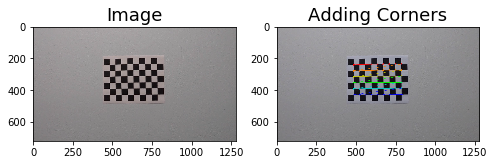

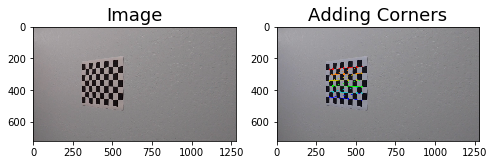

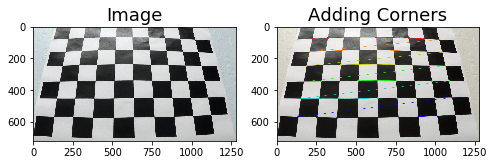

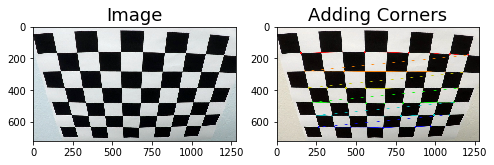

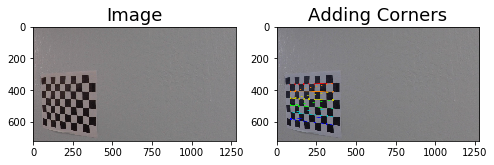

...

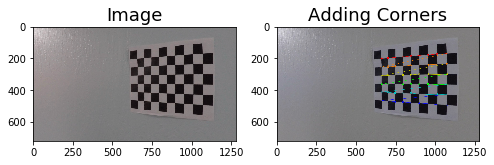

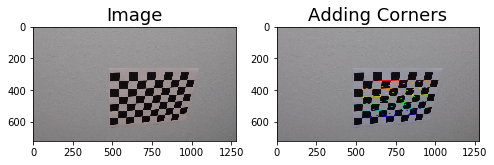

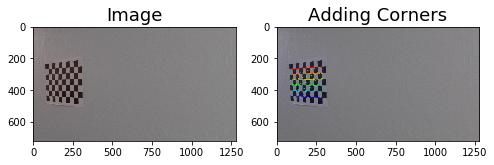

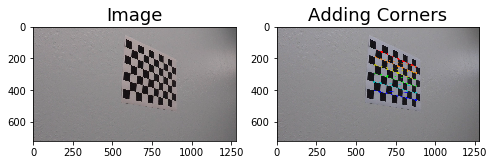

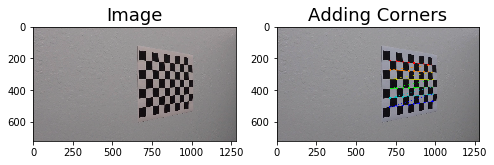

In [5]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    cv2.imshow('img',gray)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        f, (first, second) = plt.subplots(1, 2, figsize=(8,4))
        first.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
        first.set_title('Image', fontsize=18)
        second.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        second.set_title('Adding Corners', fontsize=18)

# Then I will remove the distortion using the calibration coeff got from the previous section 

In [6]:
def rem_dist(img,display=True):
    img_size = (img.shape[1],img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    if display:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(undist)
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    else:
        return undist

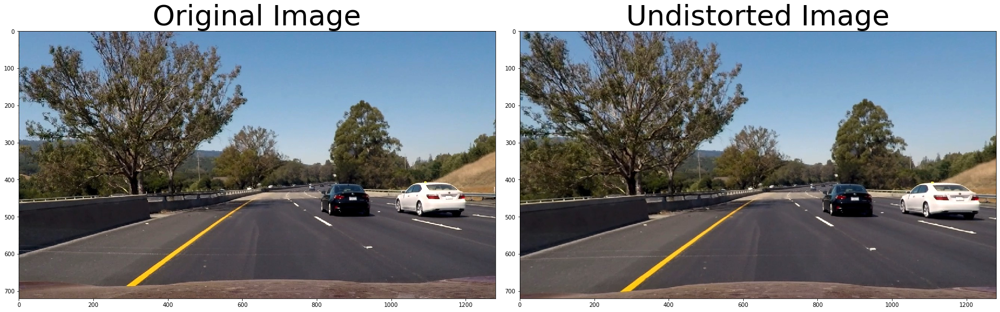

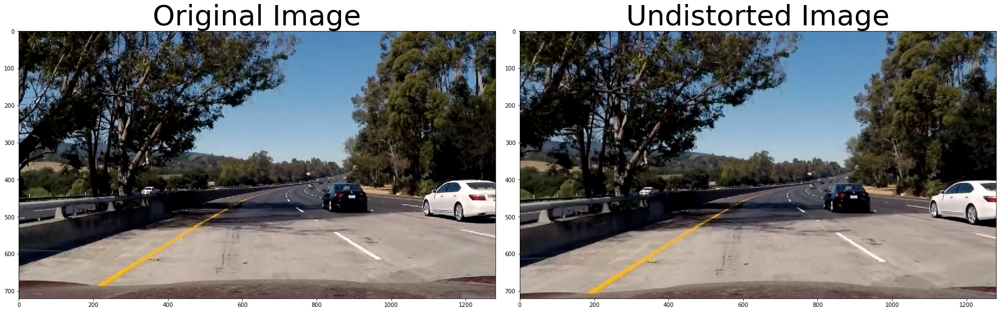

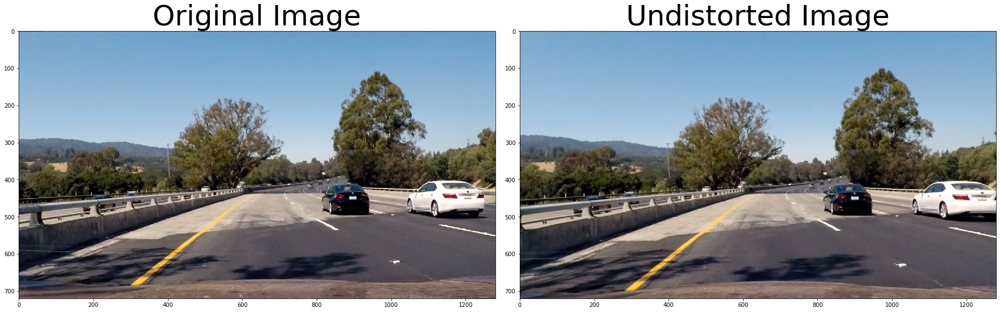

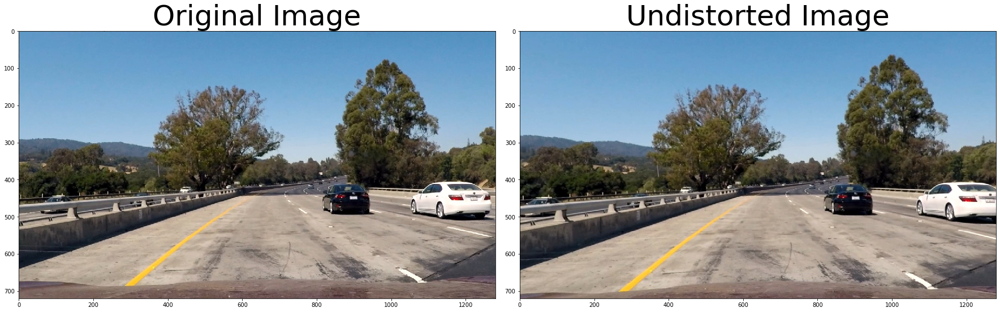

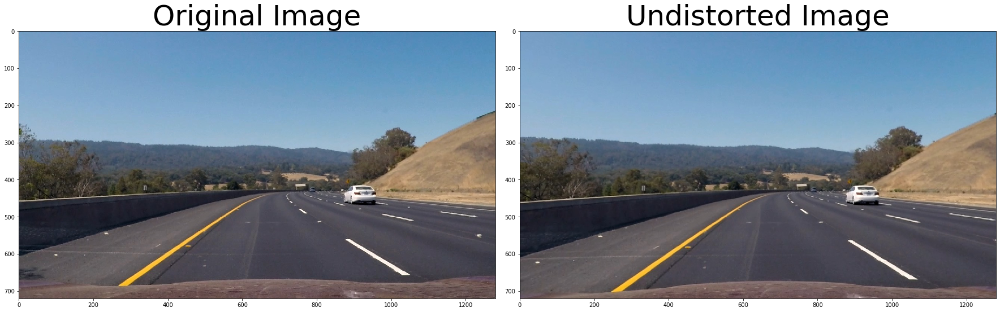

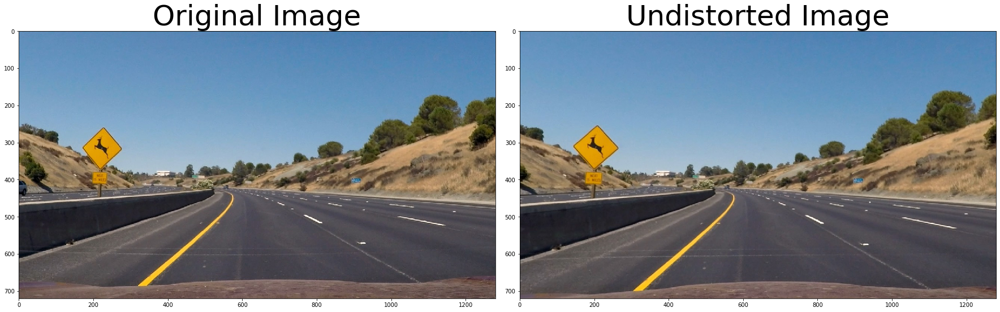

In [7]:
test_images = glob.glob('test_images/test*.jpg')
for fname in test_images:
    rem_dist(mpimg.imread(fname))

# Then I will make a Prespective Transform to the images :

In [10]:
def prespective_transform(img):
    undist_img = rem_dist(img,display=False)
    img_size = (undist_img.shape[1],undist_img.shape[0])
    src = np.float32([[490, 482],[810, 482], [1250, 720],[40, 720]])
    dst = np.float32([[0, 0], [1280, 0], [1250, 720],[40, 720]])
    M =cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return M,warped    

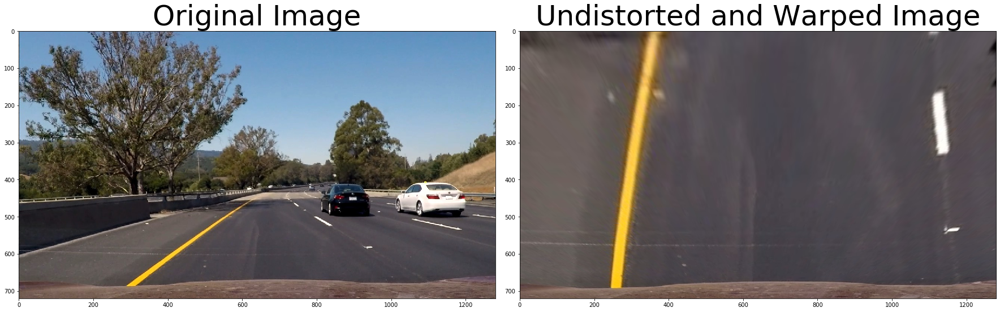

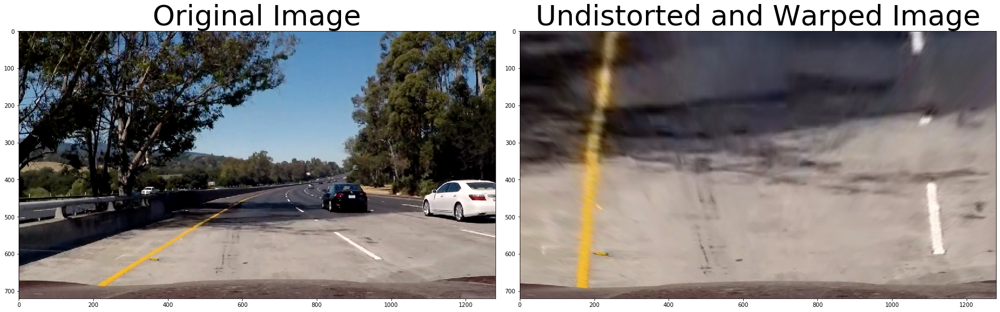

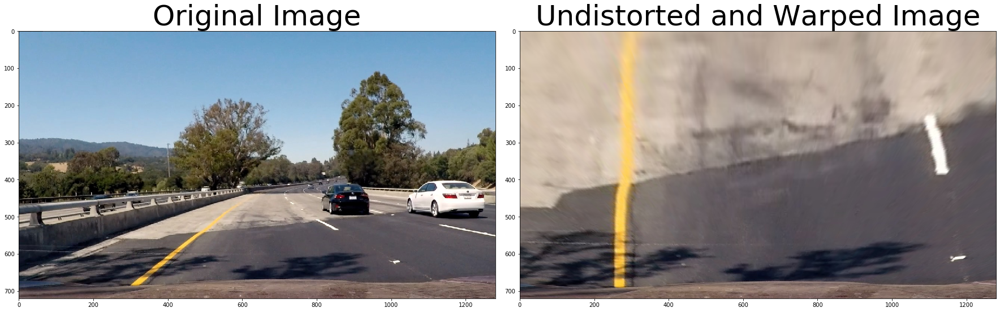

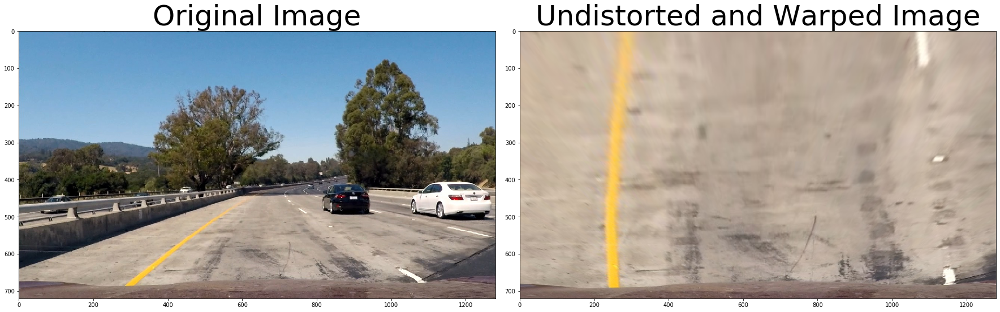

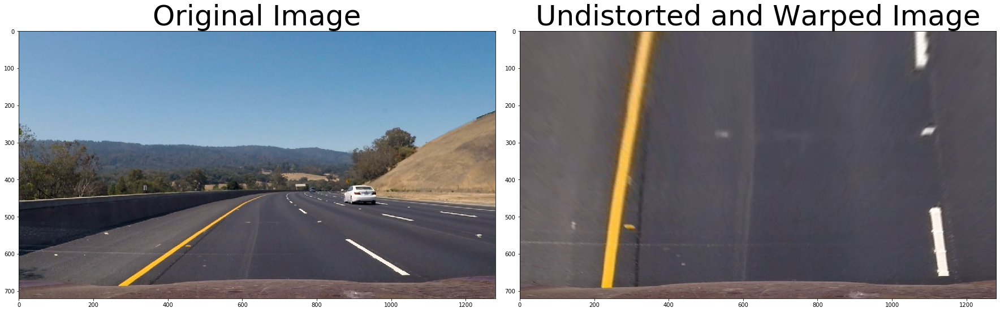

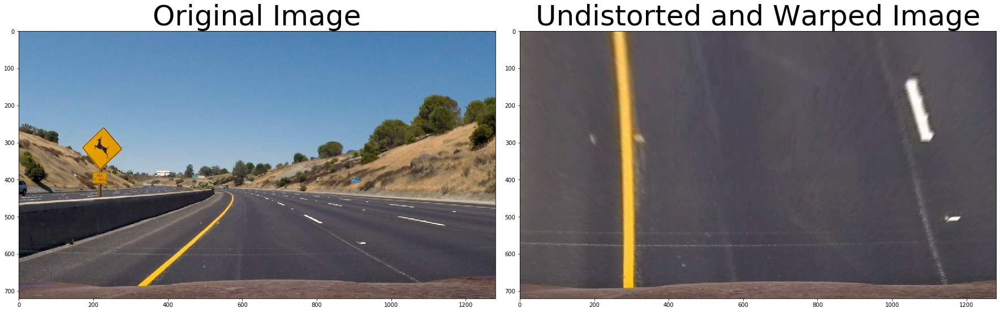

In [24]:
for image in test_images:
    img = mpimg.imread(image)
    M,wraped = prespective_transform(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(wraped)
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

# Then I will create a binary thresholded binary Image :

First I will apply a mag sobel for the warped Undistorted Images to see what it will look like:

In [38]:
def apply_mag_sobel(warped_img,orient = 'x',sobel_kernel=3, mag_thresh=(20, 100)):
    gray = cv2.cvtColor(warped_img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize = sobel_kernel)
    sobely = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    mag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(mag)/255
    mag = (mag/scale_factor).astype(np.uint8)
    binary_output = np.zeros_like(mag)
    binary_output[(mag >= mag_thresh[0]) & (mag <= mag_thresh[1])] = 1
    # Return the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warped_img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(binary_output, cmap='gray')
    ax2.set_title('Thresholded Gradient', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#     return binary_output

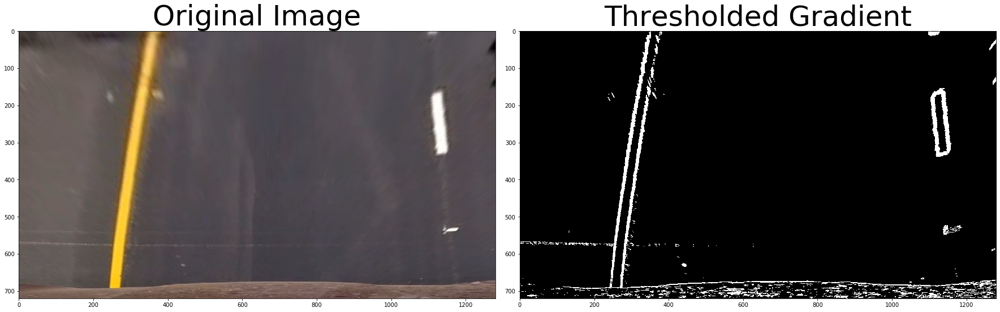

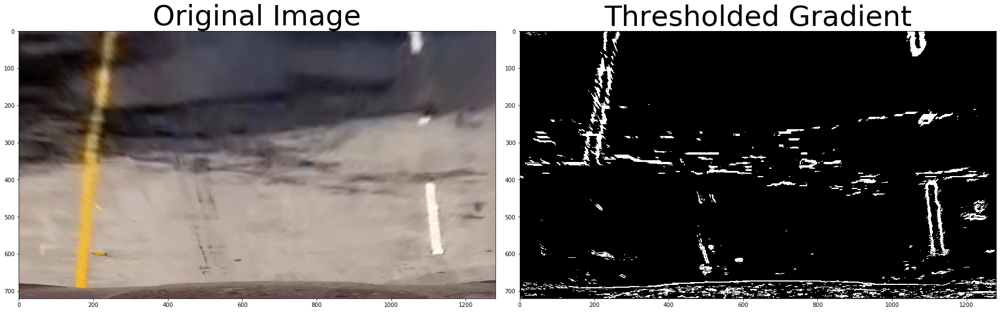

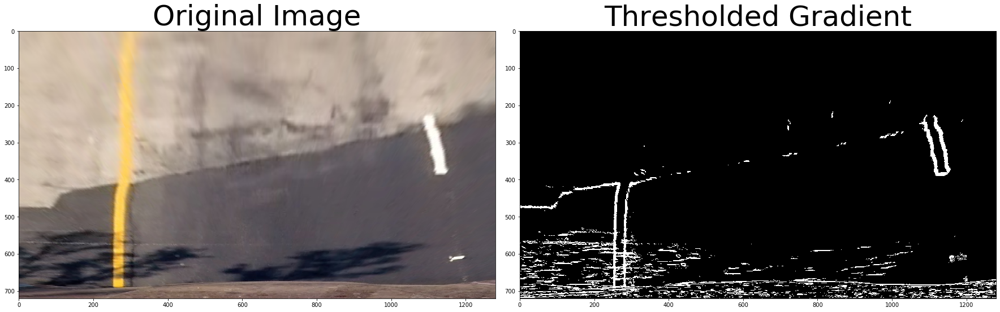

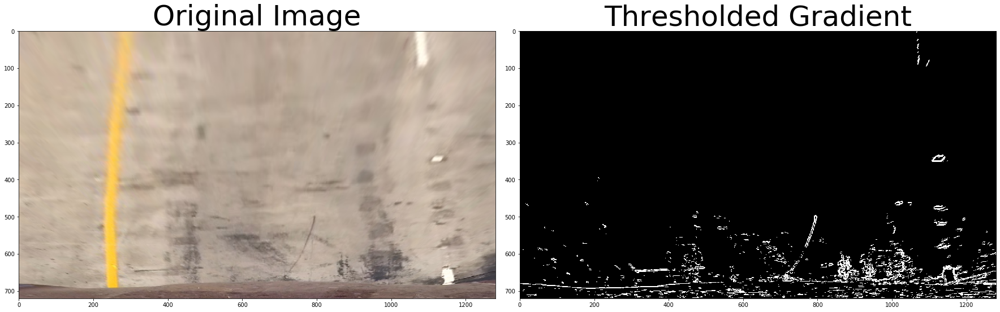

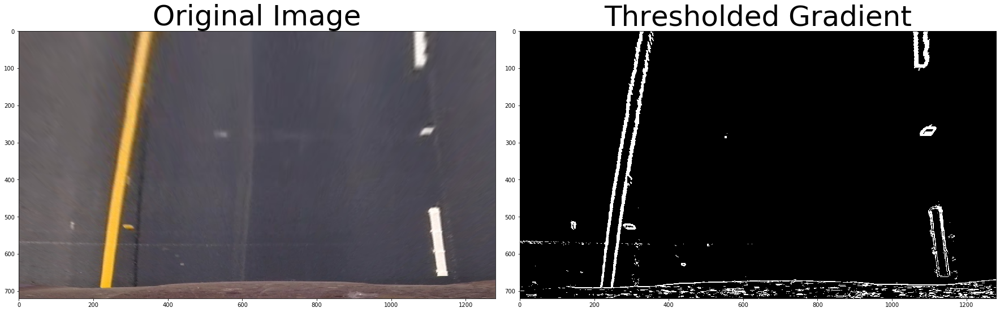

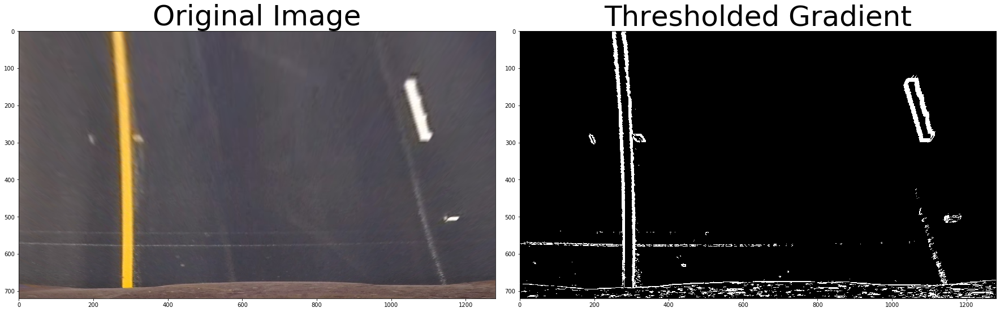

In [39]:
for image in test_images:
    img = mpimg.imread(image)
    M,warped = prespective_transform(img)
    binary_output = apply_mag_sobel(warped)

As seen from the results that it's not accurate for all of the images so in the next step i'll change the color space of the images to HLS space and examine the results :

In [47]:
def hls_conv(warped_undist_img , thresh = (185,255)):
    hls = cv2.cvtColor(warped_undist_img,cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

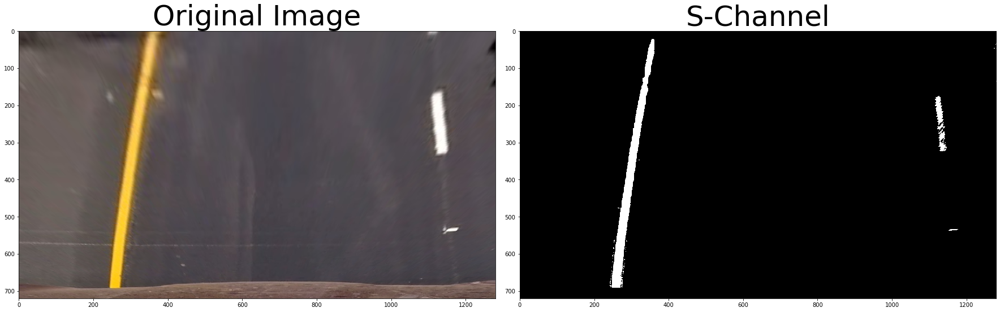

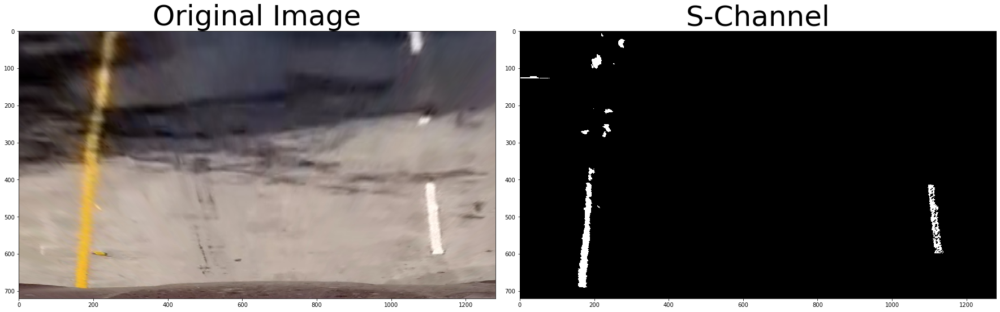

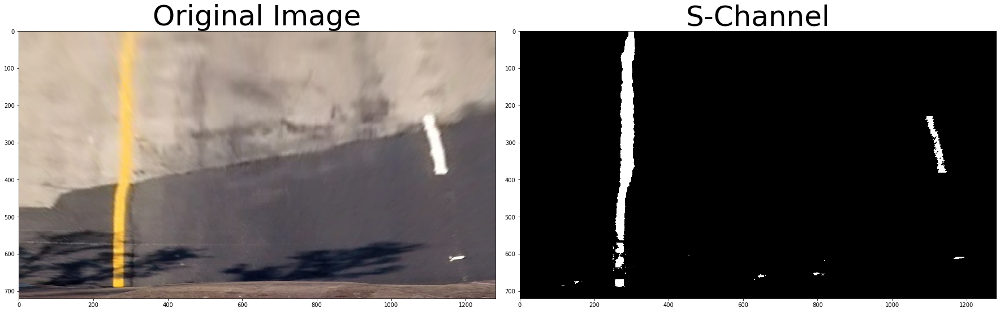

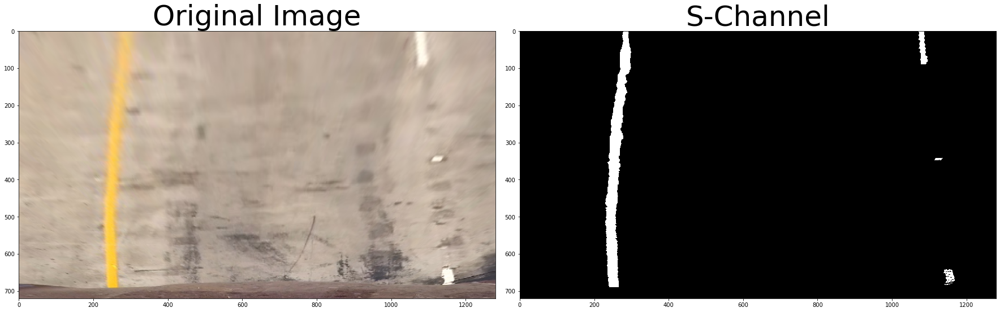

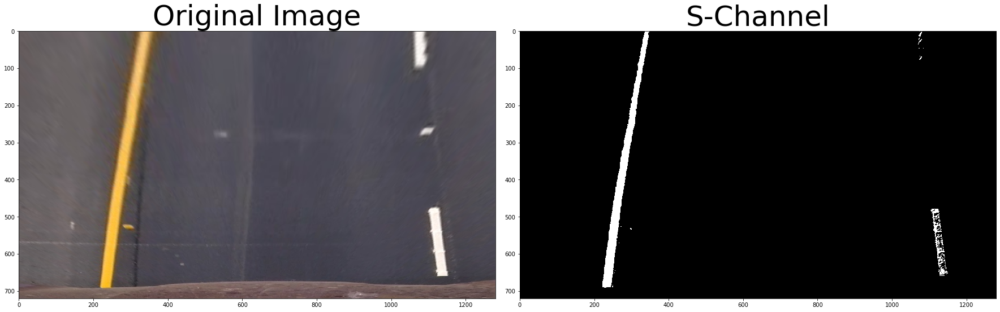

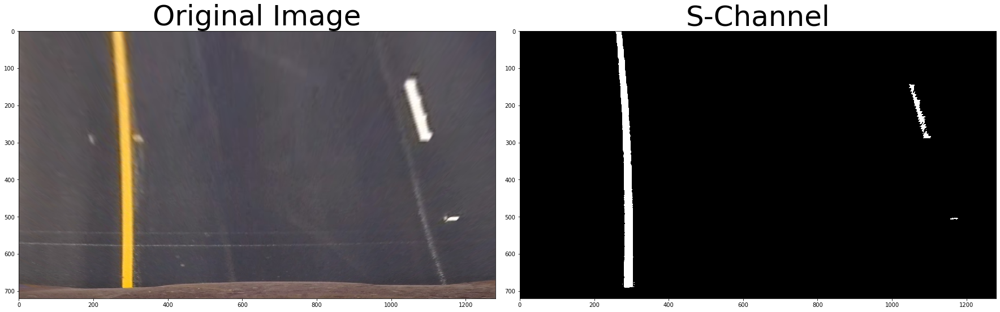

In [48]:
for image in test_images:
    img = mpimg.imread(image)
    M,warped = prespective_transform(img)
    s_channel = hls_conv(warped)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warped)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(s_channel, cmap='gray')
    ax2.set_title('S-Channel', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

As seen from the results the S-channel is the best for detecting the yellow lane  

# Then I will detect the lane lines using Histogram Peaks Method to detect the starting points of the line then i'll fit a polynomial to the lines to determine the curvature:

In [79]:
def find_lanes(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img
def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lanes(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img

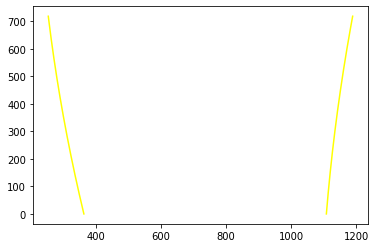

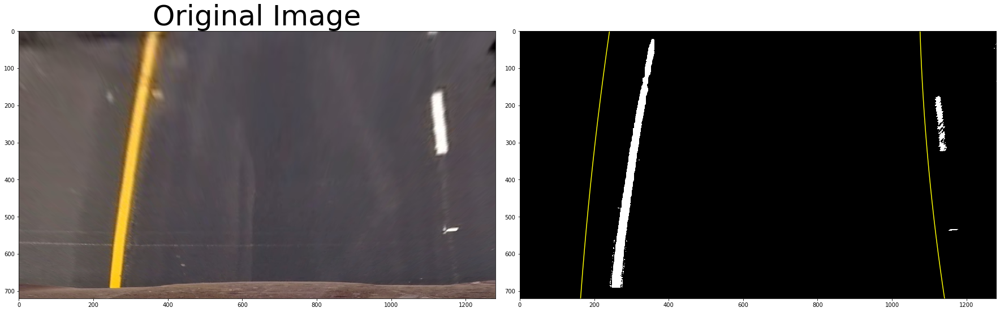

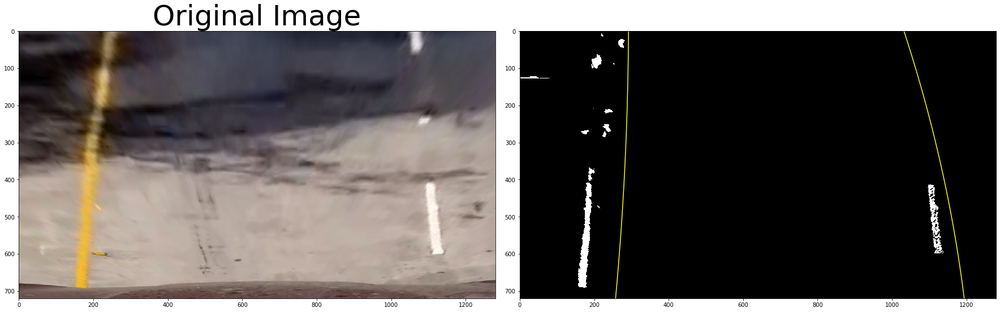

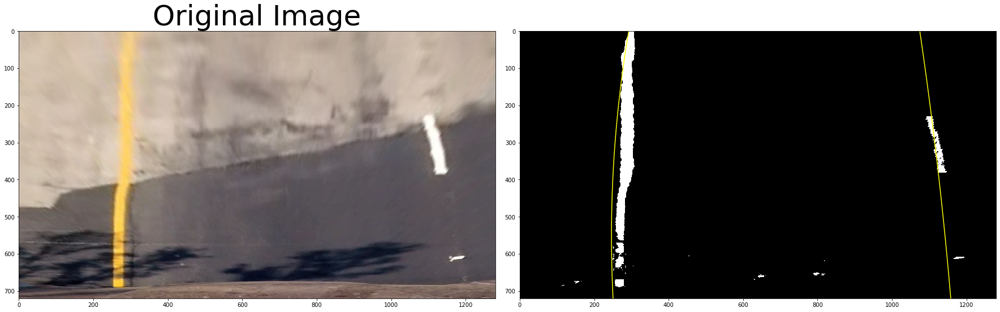

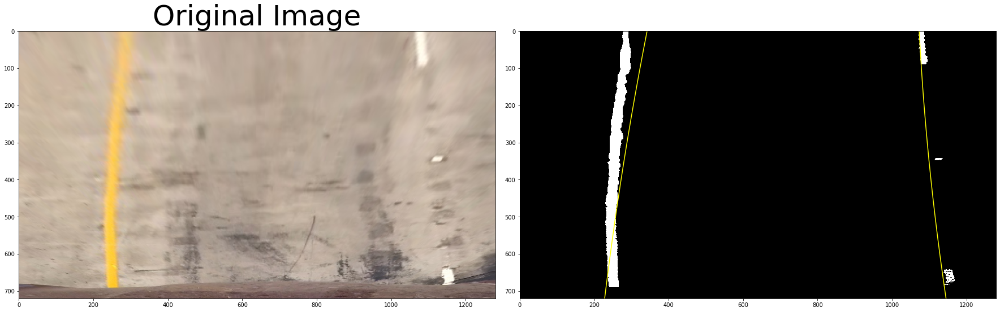

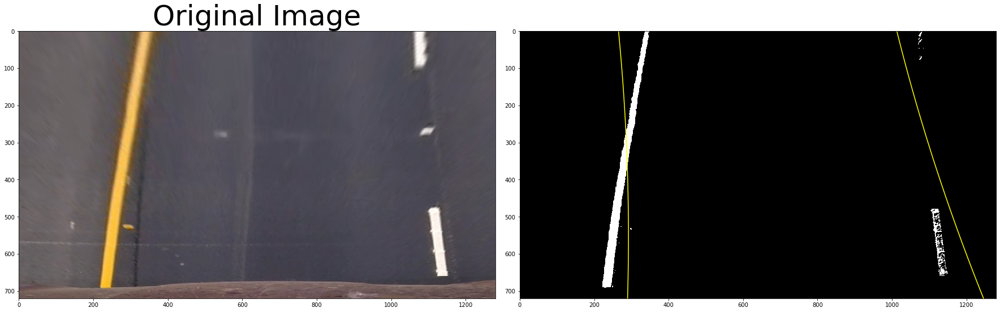

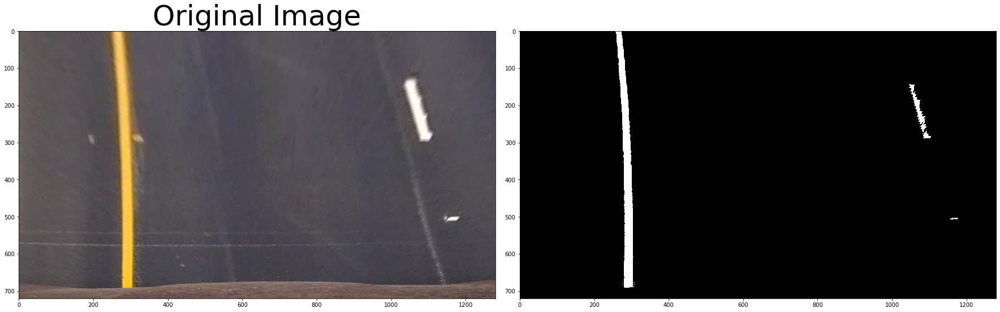

In [80]:
for image in test_images:
    img = mpimg.imread(image)
    M,warped = prespective_transform(img)
    s_channel = hls_conv(warped)
    out_img = fit_polynomial(s_channel)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warped)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(s_channel, cmap='gray')
    ax2.set_title('', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

Image number : 0, Left : 2.35 km, Right : 2.72 km
Image number : 1, Left : 3.29 km, Right : 2.02 km
Image number : 2, Left : 2.58 km, Right : 1.18 km
Image number : 3, Left : 1.08 km, Right : 3.76 km
Image number : 4, Left : 3.21 km, Right : 2.46 km
Image number : 5, Left : 1.88 km, Right : 1.55 km


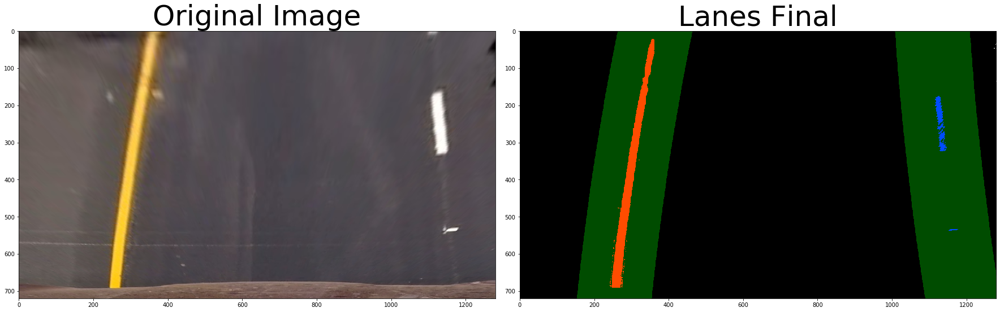

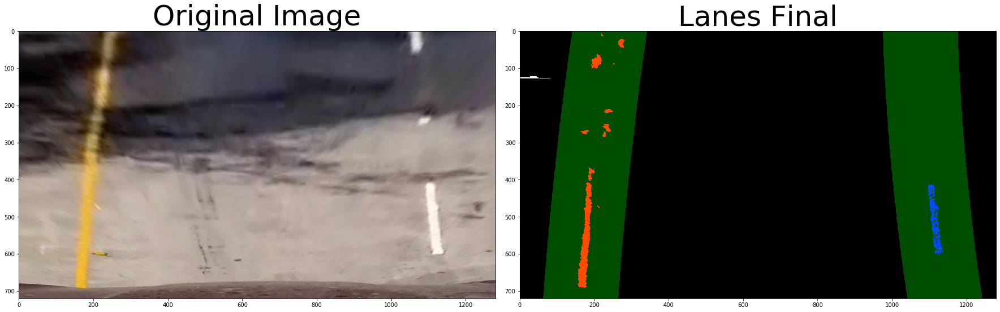

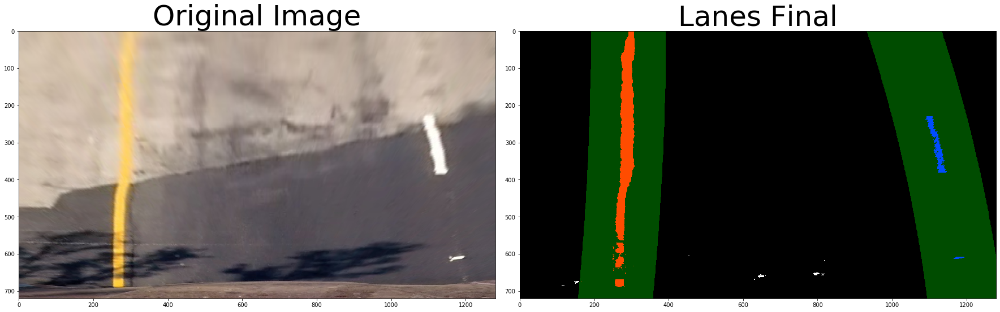

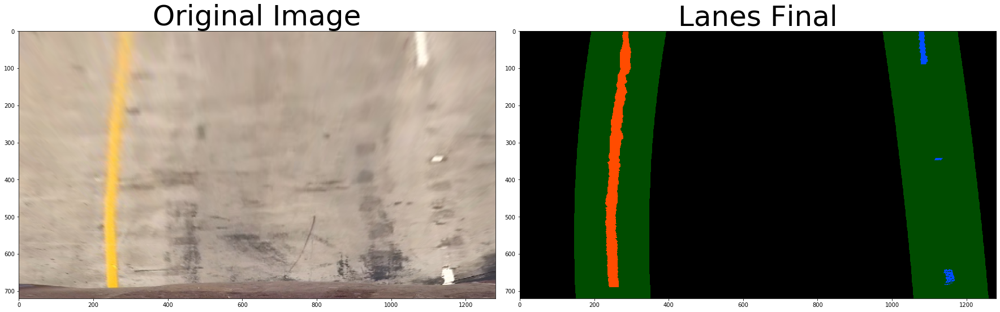

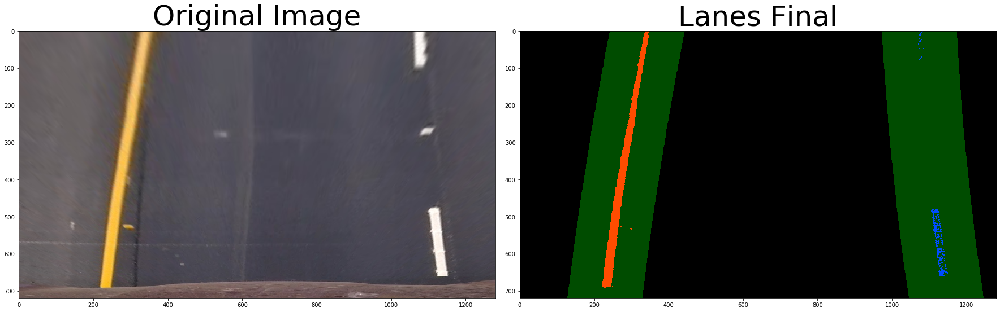

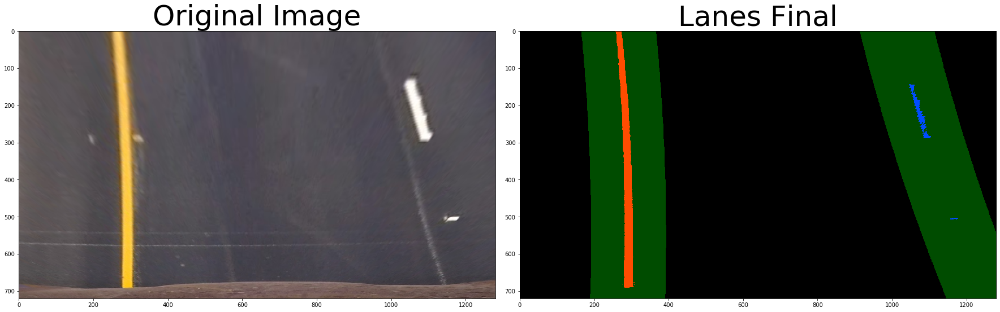

In [75]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    return left_fitx, right_fitx, ploty
def search_around_poly(binary_warped):
    margin = 100
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
#     Calculating the radius of Curvature 
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    y_max = 719
    # Calculation of R_curve (radius of curvature in kilometers)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_max*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_max*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Calculation of the center of the car
    center_car = abs(640 - ((right_curverad - left_curverad)/2))
    return result , left_curverad , right_curverad , center_car
for image in test_images:
    img = mpimg.imread(image)
    M,warped = prespective_transform(img)
    s_channel = hls_conv(warped)
    leftx, lefty, rightx, righty, out_img = find_lanes(s_channel)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    result,left,right,center = search_around_poly(s_channel)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warped)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(result)
    ax2.set_title('Lanes Final', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
for index , image in enumerate(test_images):
    img = mpimg.imread(image)
    M,warped = prespective_transform(img)
    s_channel = hls_conv(warped)
    leftx, lefty, rightx, righty, out_img = find_lanes(s_channel)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    result,left,right,center = search_around_poly(s_channel)
    print('Image number : {}, Left : {:.2f} km, Right : {:.2f} km'.format(index, left/1000, right/1000))


# After Fitting the polynomials and calculating the radius of curvature "**I have got the equations of measuring the radius of curvature from https://www.intmath.com/applications-differentiation/8-radius-curvature.php** "right detecting the lanes I'll  draw between the two lanes  :

In [90]:
def drawLine(img, left_fit, right_fit , Minv):
    yMax = img.shape[0]
    ploty = np.linspace(0, yMax - 1, yMax)
    color_warp = np.zeros_like(img).astype(np.uint8)
    # Calculate points.
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    return cv2.addWeighted(img, 1, newwarp, 0.3, 0)
def drawLaneOnImage(img):
#     left_fit, right_fit, left_fit_m, right_fit_m, _, _, _, _, _ = findLines(img)
    M,warped = prespective_transform(img)
    Minv = np.linalg.inv(M)
    s_channel = hls_conv(warped)
    leftx, lefty, rightx, righty, out_img = find_lanes(s_channel)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    output = drawLine(img, left_fit, right_fit , Minv)
    return cv2.cvtColor( output, cv2.COLOR_BGR2RGB )

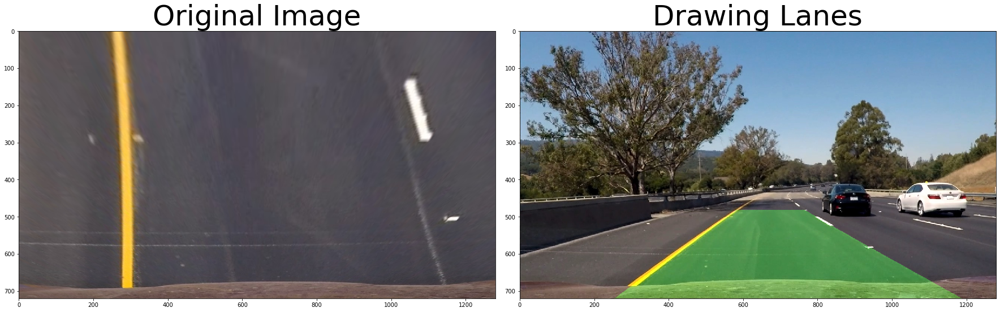

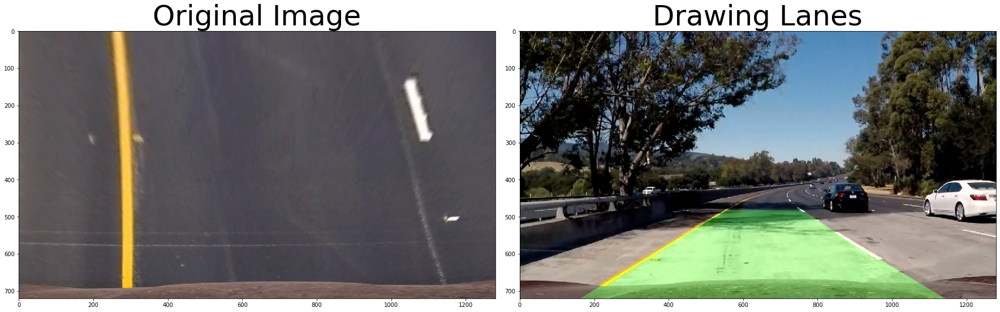

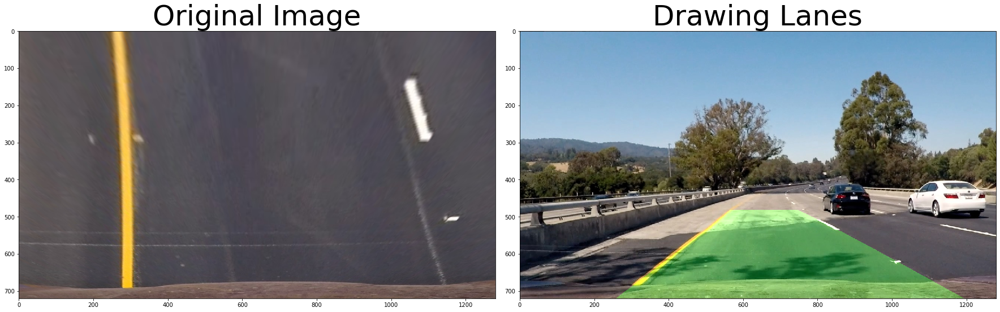

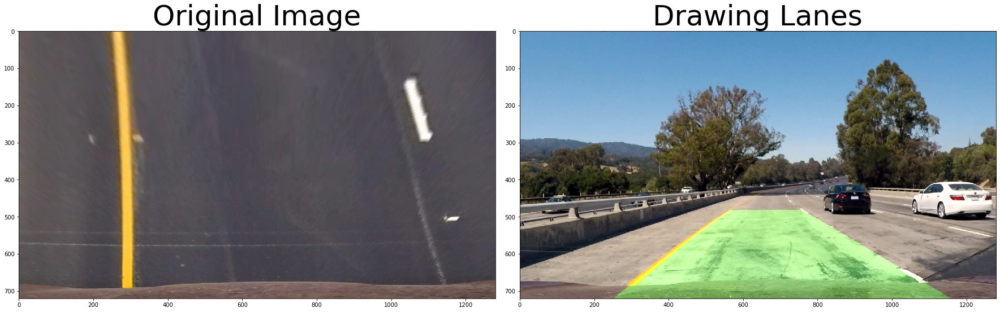

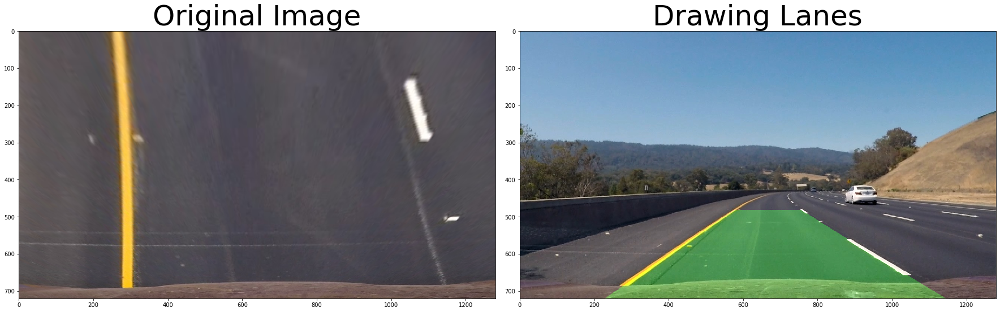

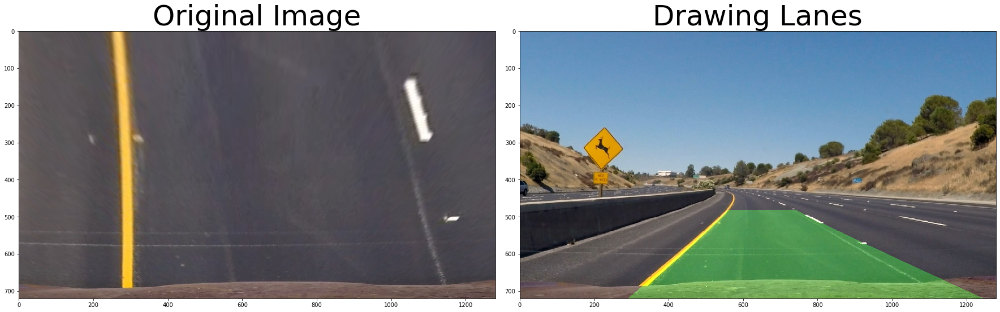

In [91]:
for image in test_images:
    img = cv2.imread(image)
    output = drawLaneOnImage(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warped)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(output)
    ax2.set_title('Drawing Lanes', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Then I'll display the numerical information (The Lane Curvature and The position of the car with respect to the center ) on the images :

In [111]:
def display(img):
    """
    Find and draw the lane lines on the image `img`.
    """
    M,warped = prespective_transform(img)
    Minv = np.linalg.inv(M)
    s_channel = hls_conv(warped)
    leftx, lefty, rightx, righty, out_img = find_lanes(s_channel)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    output = drawLine(img, left_fit, right_fit , Minv)
    # Calculate curvature
    left_fitx, right_fitx, ploty = fit_poly(s_channel.shape, leftx, lefty, rightx, righty)
#     ploty = np.linspace(0, s_channel.shape[0] - 1, s_channel.shape[0])
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    y_max = 719
    # Calculation of  radius of curvature in kilometers
    left_curverad = ((1 + (2*left_fit_cr[0]*y_max*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_max*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate vehicle center
    xMax = img.shape[1]*xm_per_pix
    yMax = img.shape[0]*ym_per_pix
    vehicleCenter = xMax / 2
    lineLeft = left_fit_m[0]*yMax**2 + left_fit_m[1]*yMax + left_fit_m[2]
    lineRight = right_fit_m[0]*yMax**2 + right_fit_m[1]*yMax + right_fit_m[2]
    lineMiddle = lineLeft + (lineRight - lineLeft)/2
    dist_from_car = lineMiddle - vehicleCenter
    if dist_from_car > 0:
        message = '{:.2f} m right'.format(dist_from_car)
    else:
        message = '{:.2f} m left'.format(-dist_from_car)
    
    # Draw info
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontColor = (255, 0, 0)
    cv2.putText(output, 'Left curvature: {:.0f} m'.format(left_curverad), (50, 50), font, 2, fontColor, 2)
    cv2.putText(output, 'Right curvature: {:.0f} m'.format(right_curverad), (50, 120), font, 2, fontColor, 2)
    cv2.putText(output, 'Vehicle is {} of center'.format(message), (50, 190), font, 2, fontColor, 2)
    return output

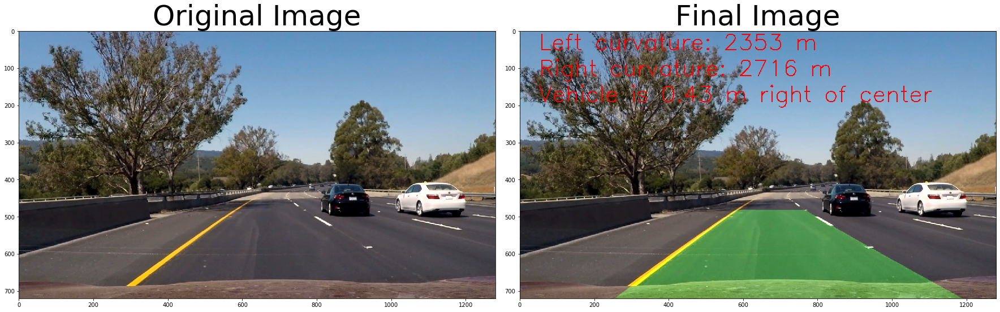

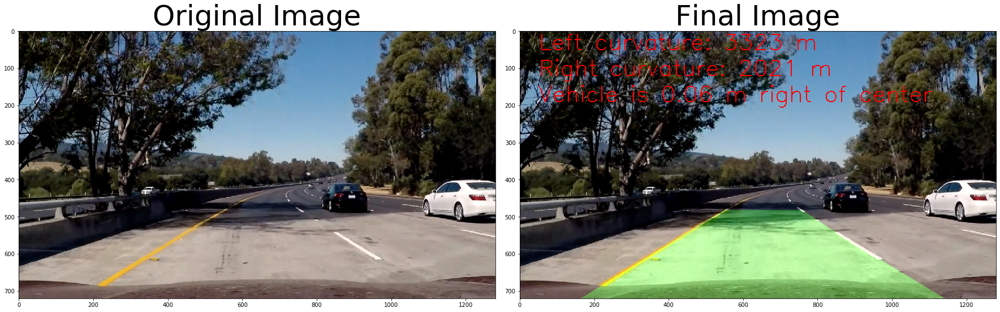

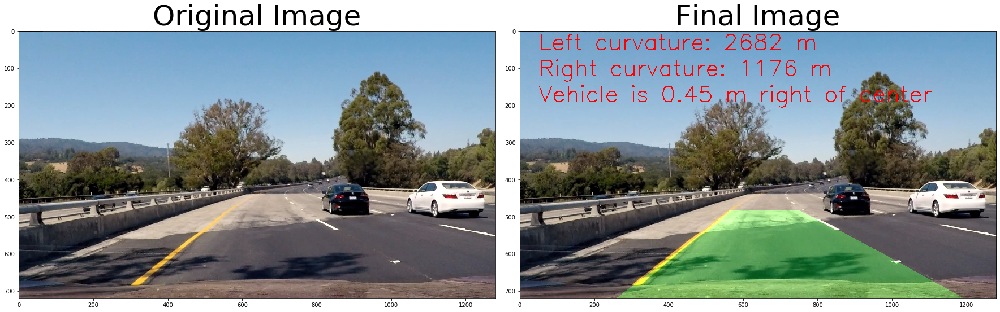

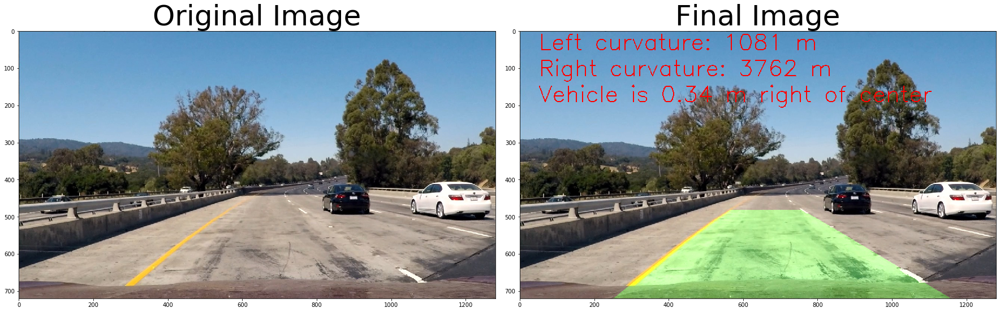

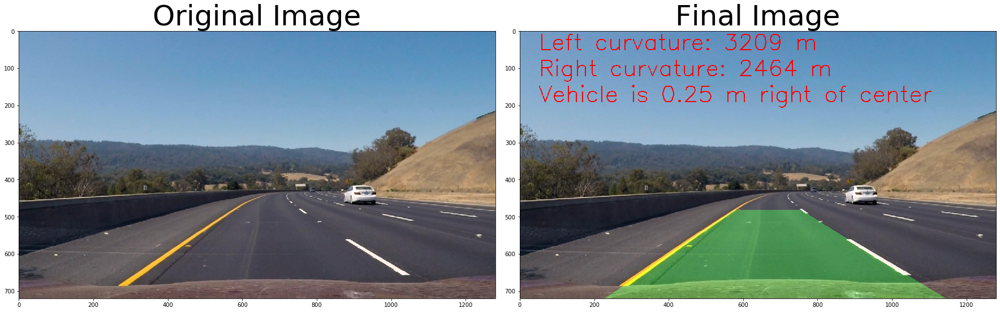

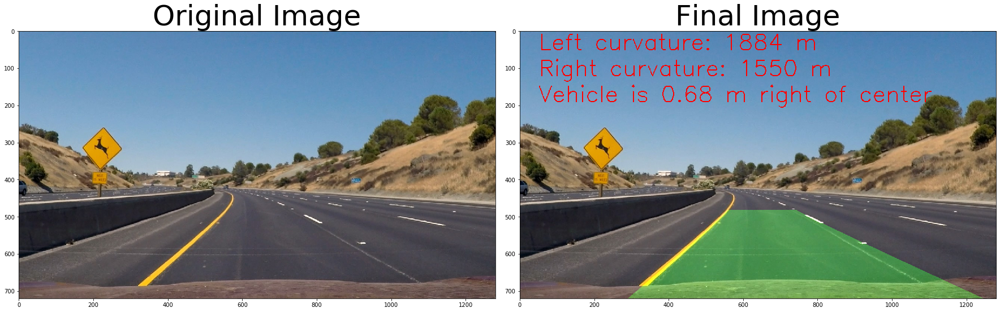

In [112]:
for image in test_images:
    img = mpimg.imread(image)
    final_result = display(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(final_result)
    ax2.set_title('Final Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# And Finally i'll make a pipeline to display my algorithm on the video provided

First I'll make a class called Lane to make it easier when processing on the Video i have used the class provided in the usefull resorces for the project 

In [125]:
class Lane():
    def __init__(self):
        self.left_fit = None
        self.right_fit = None
        self.left_fit_m = None
        self.right_fit_m = None
        self.leftCurvature = None
        self.rightCurvature = None

In [153]:
def Find_Lanes(img):
    M , warped = prespective_transform(img)
    Minv = np.linalg.inv(M)
    s_channel = hls_conv(warped)
    leftx, lefty, rightx, righty, out_img = find_lanes(s_channel)
    # Calculate curvature
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    output = drawLine(img, left_fit, right_fit , Minv)
    left_fitx, right_fitx, ploty = fit_poly(s_channel.shape, leftx, lefty, rightx, righty)
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    y_max = 719
    left_curverad = ((1 + (2*left_fit_cr[0]*y_max*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_max*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate vehicle center
    xMax = img.shape[1]*xm_per_pix
    yMax = img.shape[0]*ym_per_pix
    vehicleCenter = xMax / 2
    lineLeft = left_fit_m[0]*yMax**2 + left_fit_m[1]*yMax + left_fit_m[2]
    lineRight = right_fit_m[0]*yMax**2 + right_fit_m[1]*yMax + right_fit_m[2]
    lineMiddle = lineLeft + (lineRight - lineLeft)/2
    dist_from_car = lineMiddle - vehicleCenter
    return (left_fit, right_fit, left_fit_m, right_fit_m, left_curverad, right_curverad, dist_from_car)


In [159]:
def displayLanes(img, left_fit, right_fit, left_fit_m, right_fit_m, leftrad, rightrad, dist_from_car):
    """
    Display the lanes information on the image.
    """
    M,warped = prespective_transform(img)
    Minv = np.linalg.inv(M)
    output = drawLine(img, left_fit, right_fit,Minv)
    
    if dist_from_car > 0:
        message = '{:.2f} m right'.format(dist_from_car)
    else:
        message = '{:.2f} m left'.format(-dist_from_car)
    
    # Draw info
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontColor = (255, 255, 255)
    cv2.putText(output, 'Left curvature: {:.0f} m'.format(leftrad), (50, 50), font, 1, fontColor, 2)
    cv2.putText(output, 'Right curvature: {:.0f} m'.format(rightrad), (50, 120), font, 1, fontColor, 2)
    cv2.putText(output, 'Vehicle is {} of center'.format(message), (50, 190), font, 1, fontColor, 2)
    return output

In [166]:
def VideoDisplay(project_video,output_video):
    """
    Process the `inputVideo` frame by frame to find the lane lines, draw curvarute and vehicle position information and
    generate `outputVideo`
    """
    project_video = VideoFileClip(project_video).subclip(0,5)
    leftLane = Lane()
    rightLane = Lane()
    def processImage(img):
        left_fit, right_fit, left_fit_m, right_fit_m, leftCurvature, rightCurvature, dist_from_car = Find_Lanes(img)
        if leftCurvature > 10000:
            left_fit = leftLane.left_fit
            left_fit_m = leftLane.left_fit_m
            leftCurvature = leftLane.leftCurvature
        else:
            leftLane.left_fit = left_fit
            leftLane.left_fit_m = left_fit_m
            leftLane.leftCurvature = leftCurvature
        if rightCurvature > 10000:
            right_fit = rightLane.right_fit
            right_fit_m = rightLane.right_fit_m
            rightCurvature = rightLane.rightCurvature
        else:
            rightLane.right_fit = right_fit
            rightLane.right_fit_m = right_fit_m
            rightLane.rightCurvature = rightCurvature   
        return displayLanes(img, left_fit, right_fit, left_fit_m, right_fit_m, leftCurvature, rightCurvature, dist_from_car)
    Final_video = project_video.fl_image(processImage)
    Final_video.write_videofile(output_video, audio=False)
VideoDisplay('project_video.mp4','result.mp4')



                                                                 
t:  13%|█▎        | 159/1260 [1:53:32<05:11,  3.53it/s, now=None]
                                                                 
t:  13%|█▎        | 159/1260 [1:49:21<05:23,  3.40it/s, now=None]

t:   0%|          | 0/125 [00:00<?, ?it/s, now=None]

Moviepy - Building video result.mp4.
Moviepy - Writing video result.mp4





t:   2%|▏         | 2/125 [00:00<00:17,  6.90it/s, now=None]

t:   2%|▏         | 3/125 [00:00<00:22,  5.37it/s, now=None]

t:   3%|▎         | 4/125 [00:00<00:26,  4.53it/s, now=None]

t:   4%|▍         | 5/125 [00:01<00:28,  4.15it/s, now=None]

t:   5%|▍         | 6/125 [00:01<00:30,  3.91it/s, now=None]

t:   6%|▌         | 7/125 [00:01<00:31,  3.77it/s, now=None]

t:   6%|▋         | 8/125 [00:02<00:32,  3.62it/s, now=None]

t:   7%|▋         | 9/125 [00:02<00:32,  3.54it/s, now=None]

t:   8%|▊         | 10/125 [00:02<00:33,  3.47it/s, now=None]

t:   9%|▉         | 11/125 [00:02<00:33,  3.45it/s, now=None]

t:  10%|▉         | 12/125 [00:03<00:33,  3.42it/s, now=None]

t:  10%|█         | 13/125 [00:03<00:32,  3.45it/s, now=None]

t:  11%|█         | 14/125 [00:03<00:32,  3.43it/s, now=None]

t:  12%|█▏        | 15/125 [00:04<00:31,  3.44it/s, now=None]

t:  13%|█▎        | 16/125 [00:04<00:31,  3.46it/s, now=None]

t:  14%|█▎        | 17/125 [00:04<00:31,  3.47it/s, now=None]

t:  96%|█████████▌| 120/125 [00:35<00:01,  3.41it/s, now=None]

t:  97%|█████████▋| 121/125 [00:35<00:01,  3.46it/s, now=None]

t:  98%|█████████▊| 122/125 [00:35<00:00,  3.44it/s, now=None]

t:  98%|█████████▊| 123/125 [00:36<00:00,  3.46it/s, now=None]

t:  99%|█████████▉| 124/125 [00:36<00:00,  3.46it/s, now=None]

t: 100%|██████████| 125/125 [00:36<00:00,  3.48it/s, now=None]

                                                                 
t:  13%|█▎        | 159/1260 [1:54:09<05:11,  3.53it/s, now=None]
                                                                 
t:  13%|█▎        | 159/1260 [1:49:58<05:23,  3.40it/s, now=None]

Moviepy - Done !
Moviepy - video ready result.mp4


In [167]:
from IPython.display import HTML
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format('result.mp4'))